In [25]:
import pandas as pd
import geopandas as gpd
from glob import glob
import folium
from datetime import datetime as dt
import seaborn as sns
from matplotlib import pyplot as plt

# requires `scrape_house_speakingsame_suburbs.py` to be run first
top_sub_path = sorted(glob("../data/raw/top_rent_suburbs_*.csv"))[-1]
shp_file = "../data/raw/suburbs/SAL_2021_AUST_GDA2020.shp"


sf = gpd.read_file(shp_file)
sf.dropna(inplace = True)
sf['geometry'] = sf['geometry'].to_crs("+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")
vic_sf = sf.query("STE_NAME21=='Victoria'")

top_sub = pd.read_csv(top_sub_path)
top_sub['value_'] = top_sub['value'].copy()
top_sub['value'] = top_sub['value'].str.replace('\$|,','').astype(int)

vic_sf['suburb'] = vic_sf['SAL_NAME21'].str.replace(' \(Vic\.\)', '')

/tmp/ipykernel_181/2697294849.py:21: FutureWarning: The default value of regex will change from True to False in a future version.
  top_sub['value'] = top_sub['value'].str.replace('\$|,','').astype(int)
/tmp/ipykernel_181/2697294849.py:23: FutureWarning: The default value of regex will change from True to False in a future version.
  vic_sf['suburb'] = vic_sf['SAL_NAME21'].str.replace(' \(Vic\.\)', '')
/tmp/ipykernel_181/2697294849.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vic_sf['suburb'] = vic_sf['SAL_NAME21'].str.replace(' \(Vic\.\)', '')


In [26]:
g_top_sub = gpd.GeoDataFrame(top_sub[2:].merge(vic_sf, on='suburb'))

In [27]:
geo_json = g_top_sub[['suburb', 'geometry']].to_json()

In [28]:
top_sub

,rank,suburb,value,link,page,value_
0,1,Mount Buller,38333,http://house.speakingsame.com/profile.php?sta=...,0,"$38,333"
1,2,Falls Creek,25500,http://house.speakingsame.com/profile.php?sta=...,0,"$25,500"
2,3,Flinders,1535,http://house.speakingsame.com/profile.php?sta=...,0,"$1,535"
3,4,Sawmill Settlement,1462,http://house.speakingsame.com/profile.php?sta=...,0,"$1,462"
4,5,Portsea,1350,http://house.speakingsame.com/profile.php?sta=...,0,"$1,350"
...,...,...,...,...,...,...
1083,1084,Dartmoor,166,http://house.speakingsame.com/profile.php?sta=...,21,$166
1084,1084,Dimboola,166,http://house.speakingsame.com/profile.php?sta=...,21,$166
1085,1084,Dunnstown,166,http://house.speakingsame.com/profile.php?sta=...,21,$166
1086,1087,Jeparit,161,http://house.speakingsame.com/profile.php?sta=...,21,$161


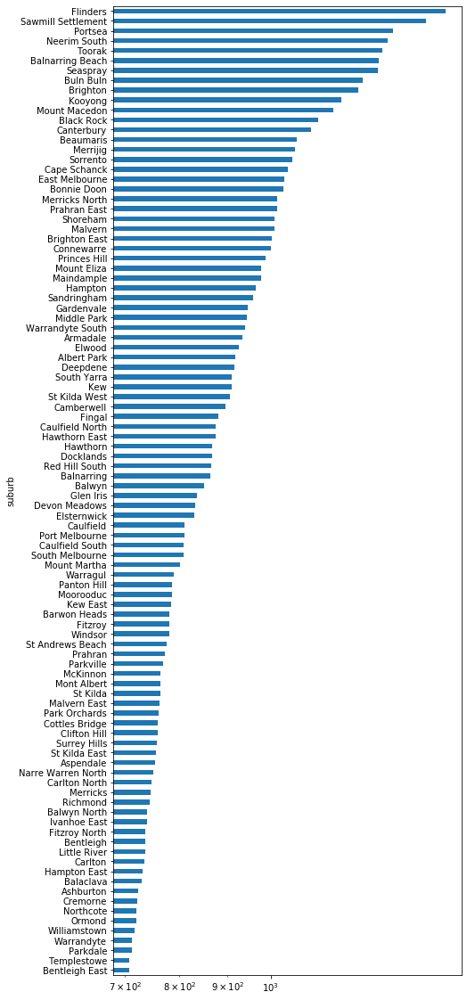

In [29]:
fig,ax = plt.subplots(1,1,figsize=(7,20))
top_sub[2:100].set_index('suburb')['value'].sort_values().plot.barh(ax=ax, logx=True)

In [30]:
top_sub.describe()

,rank,value,page
count,1088.000000,1088.000000,1088.000000
mean,543.170956,516.276654,10.384191
std,313.814649,1388.491678,6.284969
min,1.000000,155.000000,0.000000
25%,272.250000,340.000000,5.000000
50%,543.000000,423.000000,10.000000
75%,811.000000,526.500000,16.000000
max,1088.000000,38333.000000,21.000000


In [31]:
m = folium.Map(location=[-37.840935, 144.946457], tiles="Stamen Terrain", zoom_start=10)

# refer to the folium documentations on more information on how to plot aggregated data.
c = folium.Choropleth(
    geo_data=geo_json, # geoJSON 
    name='choropleth', # name of plot
    data=top_sub[2:], # data source
    columns=['suburb','value'], # the columns required
    key_on='properties.suburb', # this is from the geoJSON's properties
    fill_color='YlOrRd', # color scheme
    nan_fill_color='black',
    legend_name='value'
)

c.add_to(m)

m

# Properties

In [32]:
# scraping results can be downloaded, or obtained and preprocessed through scrape_house_speakingsame_buy|rent.py and preprocess_house_speakingsame.py
df = pd.read_csv(sorted(glob('../data/curated/housespeakingsame/*.csv'))[-1], parse_dates=['rent_date', 'sold_date', 'last_sold_date'])
df['centroid'] = df.apply(lambda x: (x['lat'], x['lng']), axis=1)

IndexError: list index out of range

In [ ]:
fig, (ax1, ax2) = plt.subplots(2,1,figsize=(20,20))
top5 = df.loc[df['suburb'].isin(top_sub.head(5)['suburb'])]
sns.lineplot(data=top5.groupby(['rent_date','suburb'])['rent_price'].mean().reset_index().sort_values("rent_date"), 
             x='rent_date', y='rent_price', hue='suburb', ax=ax1)
ax1.set_yscale('log')
ax1.set_title('Average Rent Price')
sns.lineplot(data=top5.groupby(['sold_date','suburb'])['sold_price'].mean().reset_index().sort_values("sold_date"), 
             x='sold_date', y='sold_price', hue='suburb', ax=ax2)
ax2.set_yscale('log')
ax2.set_title('Average Sold Price')